# This cat does not exist
__Суммарное количество баллов: 10__

Цель этого задания - создать котов, которых не существует. В ходе данного задания вы обучите DCGAN и VAE, которые являются одними из первых генеративных моделей. Для этого задания вам наверняка потребуется GPU с CUDA, поэтому рекомендуется использовать Google Colab.

In [ ]:
import torch
from torch import nn
from torch.optim import Adam
from torch.nn import functional as F
from torch.utils.data import Dataset, DataLoader
import os 
import cv2
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import random
import numpy as np

%matplotlib inline

In [ ]:
def random_noise(batch_size, channels, side_size):
    return torch.randn(batch_size, channels, side_size, side_size).cuda()

In [ ]:
def visualise(imgs, rows=2):
    imgs = (imgs.transpose(1, 3) + 1) / 2
    imgs = torch.cat([imgs[i::rows] for i in range(rows)], dim=1)
    cols = len(imgs)
    imgs = (torch.cat(list(imgs), dim=1)).cpu().numpy()[:, :, ::-1]
    plt.figure(figsize=(cols*1.5, rows*1.5))
    plt.imshow(imgs)
    plt.axis('off')
    plt.tight_layout()
    plt.show()

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
class CatDataset(Dataset):
    def __init__(self, path_to_dataset="/content/drive/MyDrive/ML_HSE/cat_136", size=64):
        self.photo_names = os.listdir(path_to_dataset)
        self.path_base = path_to_dataset
        self.size = size
    
    def __getitem__(self, index):
        path = self.path_base + "/" + self.photo_names[index]
        img = cv2.imread(path) # 136 x 136
        crop_rate = 8
        x_crop = random.randint(0, crop_rate)
        y_crop = random.randint(0, crop_rate)
        img = img[x_crop:136 - crop_rate + x_crop, y_crop:136 - crop_rate + y_crop]
        img = cv2.resize(img, (self.size, self.size), interpolation=cv2.INTER_CUBIC)
        return 2 * torch.tensor(img).float().transpose(0, 2) / 255. - 1
    
    def __len__(self):
        return len(self.photo_names)

In [ ]:
dataset = CatDataset()

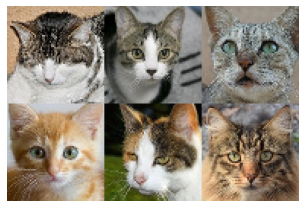

In [ ]:
visualise(torch.cat([dataset[i].unsqueeze(0) for i in [3, 15, 182, 592, 394, 2941]], dim=0))

### Задание 1 (2 балла)
Для начала реализуем кодировщик для нашего VAE. Предлагается использовать следующую архитектуру:

![](imgs/VAE_enc.png)

Для ее реализации вам потребуются модули `nn.Conv2d`, `nn.ReLU`, `nn.Flatten` и `nn.Linear`.

#### Методы
* `__init__` - принимает на вход `img_size`, `latent_size`, `start_channels` и `downsamplings`. Первый аргумент - высота и ширина картинки в пикселях. Второй аргумент - размерность латентного пространства. `start_channels` отвечает за то, сколько каналов должно быть в картинке перед тем, как к ней будут применены downsampling блоки. `downsamplings` - это количество downsampling блоков, которые должны быть применены к картинке. В каждом таком блоке количество каналов увеличивается в два раза.


* `forward` - принимает на вход батч `x`, возвращает эмбеддинг в латентном пространстве `z` и параметры распределения `(mu, sigma)`.

In [ ]:
class MyModule(nn.Module):
    def __init__(self):
        super().__init__()
        self.mods = nn.ModuleList([])

    def forward(self, x):
        for module in self.mods:
            x = module(x)

class Encoder(nn.Module):
    def __init__(self, img_size=128, latent_size=512, start_channels=16, downsamplings=5):
        super().__init__()
        self.img_size = img_size
        self.latent_size = latent_size
        self.start_channels = start_channels
        self.channels = [start_channels*2**i for i in range(downsamplings)]
        self.downsamplings = downsamplings
        self.module_list = []
        self.conv_block = nn.Conv2d(in_channels = 3, 
                                            out_channels = self.start_channels, 
                                            kernel_size = 1,
                                            stride = 1,
                                            padding = 0)
        for i in range(downsamplings):
            self.module_list.append(nn.Conv2d(in_channels = self.channels[i], 
                                              out_channels = 2 * self.channels[i], 
                                              kernel_size = 3,                
                                              stride = 2,
                                              padding = 1))
            self.module_list.append(nn.BatchNorm2d(num_features = 2 * self.channels[i]))
            self.module_list.append(nn.ReLU()) 
        self.downsampling_blocks = nn.Sequential(*self.module_list)
        self.flatten_block = nn.Flatten()
        self.linear_block = nn.Sequential(nn.Linear(in_features = self.start_channels * self.img_size**2 // (2 ** self.downsamplings), 
                                      out_features = 256),
                                          nn.ReLU(),
                                          nn.Linear(256, 2*self.latent_size))

                                    
    
    def forward(self, x):
        x = self.conv_block(x)
        x = self.downsampling_blocks(x)
        x = self.flatten_block(x)
        x = self.linear_block(x)
        mu, sigma = x[:, :self.latent_size], torch.exp(x[:, self.latent_size:])
        embedding = mu + sigma * torch.randn(mu.size()).to('cuda:0')
        return embedding, (mu, sigma)

### Задание 2 (3 балла)
Теперь реализуем декодер для VAE. Предлагается использовать следующую архитектуру:

![](imgs/VAE_dec.png)

Для ее реализации вам потребуются модули `nn.Linear`, `nn.Unflatten`, `nn.ConvTranspose2d`, `nn.ReLU` и `nn.Sigmoid`.

#### Методы
* `__init__` - принимает на вход `img_size`, `latent_size`, `end_channels` и `upsamplings`.  Первый аргумент - высота и ширина картинки в пикселях. Второй аргумент - размерность латентного пространства. `end_channels` отвечает за то, сколько каналов должно быть после всех upsampling блоков. `upsamplings` - это количество upsampling блоков, которые должны быть применены к картинке. В каждом таком блоке количество каналов уменьшается в два раза.


* `forward` - принимает на вход `z` - тензор с латентным представлением изображений. Возвращает батч восстановленных изображений.

#### Важно
`Linear Model` в схеме - это полносвязная сеть из нескольких слоев. Предлагается такая архитектура:

`[Linear(c * img_size // 2*N -> 256), ReLU, Linear(256 -> 2 * latent_size)]`

In [ ]:
class Decoder(nn.Module):
    def __init__(self, img_size=128, latent_size=512, end_channels=16, upsamplings=5):
        super().__init__()
        self.img_size = img_size
        self.latent_size = latent_size
        self.end_channels = end_channels
        self.upsamplings = upsamplings
        self.channels = list(reversed([self.end_channels*2**i for i in range(1, upsamplings+1)]))
        self.module_list = []
        self.linear_block = nn.Sequential(nn.Linear(in_features = self.latent_size, 
                                      out_features = 256),
                                          nn.ReLU(),
                                          nn.Linear(in_features = 256, 
                                      out_features = self.end_channels*self.img_size**2 // 2**self.upsamplings))
                                          
        self.unflatten_block = nn.Unflatten(1, torch.Size([self.end_channels * 2**self.upsamplings, self.img_size // 2**self.upsamplings, self.img_size // 2**self.upsamplings]))
        for i in range(upsamplings):
            self.module_list.append(nn.ConvTranspose2d(in_channels = self.channels[i], 
                                                           out_channels = self.channels[i] // 2, 
                                                           kernel_size = 4,
                                                           stride = 2,
                                                           padding = 1))
            self.module_list.append(nn.BatchNorm2d(num_features = self.channels[i] // 2))
            self.module_list.append(nn.ReLU()) 
        self.upsampling_blocks = nn.Sequential(*self.module_list)
        self.conv_block = nn.Conv2d(in_channels = self.end_channels, 
                                            out_channels = 3, 
                                            kernel_size = 1,
                                            stride = 1,
                                            padding = 0)
        self.tanh = nn.Tanh()
        
        
    def forward(self, z):
        z = self.linear_block(z)
        z = self.unflatten_block(z)
        z = self.upsampling_blocks(z)
        z = self.conv_block(z)
        image = self.tanh(z)
        return image

### Задание 3 (5 баллов)
Наконец, объединим Encoder и Decoder в Variational Autoencoder.

Полностью архитектура выглядит так:
![](imgs/VAE.png) 

Из нее можно выделить две части: Encoder (по изображению возвращает mu и sigma) и Decoder (по случайному шуму восстанавливает изображение). На высоком уровне VAE можно представить так:

![](imgs/VAE_highlevel.png)

В данном задании вам необходимо реализовать полную архитектуру VAE.

#### Методы
* `__init__` - принимает на вход `img_size`, `downsamplings`, `latent_size`, `linear_hidden_size`, `down_channels` и `up_channels`. `img_size` - размер стороны входного изображения. `downsamplings` - количество downsampling (и upsampling) блоков. `latent_size` - размер латентного пространства, в котором в который будет закодирована картинка. `linear_hidden_size` количество нейронов на скрытом слое полносвязной сети в конце encoder'а. Для полносвязной сети decoder'а это число стоит умножить на 2. `down_channels` - количество каналов, в которое будет преобразовано трехцветное изображение перед применением `downsampling` блоков. `up_channels` - количество каналов, которое должно получиться после применения всех upsampling блоков.

* `forward` - принимает на вход `x`. Считает распределение $N(\mu, \sigma^2)$ и вектор $z \sim N(\mu, \sigma^2)$. Возвращает $x'$ - восстановленную из вектора $z$ картинку и $D_{KL}(N(\mu, \sigma^2), N(0, 1)) = 0.5 \cdot (\sigma^2 + \mu^2 - \log \sigma^2 - 1)$.

* `encode` - принимает на вход `x`. Возвращает вектор из распределения $N(\mu, \sigma^2)$.

* `decode` - принимает на вход `z`. Возвращает восстановленную по вектору картинку.

* `save` - сохраняет чекпоинт обученной модели.

* `load` - загружает сохраненный чекпоинт обученной модели.


#### Если хочется улучшить качество
https://arxiv.org/pdf/1906.00446.pdf

In [ ]:
class VAE(nn.Module):
    def __init__(self, img_size=128, downsamplings=6, latent_size=256, down_channels=6, up_channels=12):
        super().__init__()
        self.encoder = Encoder(img_size=img_size, latent_size=latent_size, start_channels=down_channels, downsamplings=downsamplings)
        self.decoder = Decoder(img_size=img_size, latent_size=latent_size, end_channels=up_channels, upsamplings=downsamplings)
        
    def forward(self, x):
        z, (mu, sigma) = self.encoder.forward(x)
        x_pred = self.decoder.forward(z)
        kld = 0.5 * (sigma.pow(2) + mu.pow(2) - torch.log(sigma.pow(2)) - 1)
        return x_pred, kld
    
    def encode(self, x):
        return self.encoder.forward(x)[0]
    
    def decode(self, z):
        return self.decoder.forward(z)
    
    def save(self):
        torch.save(self.state_dict(), "MyModel.pth")
    
    def load(self):
        self.load_state_dict(torch.load("MyModel.pth"))

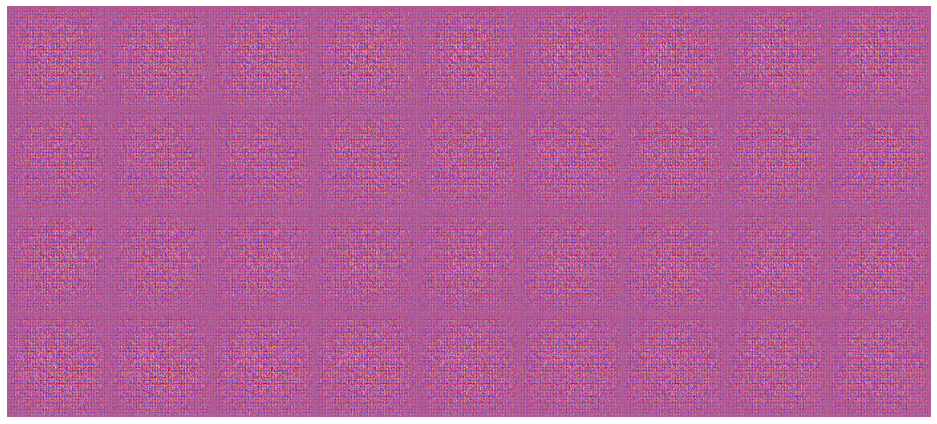

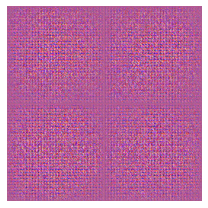

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 1 | Reconstruction loss: 12092.670689932307 | KLD loss: 74.9060363006888


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 2 | Reconstruction loss: 6704.6753475592 | KLD loss: 195.85447178716245


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 3 | Reconstruction loss: 5919.430054848239 | KLD loss: 227.0490808427704


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 4 | Reconstruction loss: 5575.44352200905 | KLD loss: 241.46162073360466


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 5 | Reconstruction loss: 5331.359603597511 | KLD loss: 249.91465031878548


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 6 | Reconstruction loss: 5110.084427922408 | KLD loss: 260.85692876022057


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 7 | Reconstruction loss: 4982.046825337854 | KLD loss: 268.32409689293144


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 8 | Reconstruction loss: 4889.369056843822 | KLD loss: 270.37447044419946


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 9 | Reconstruction loss: 4723.748955957638 | KLD loss: 279.6476299688683


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 10 | Reconstruction loss: 4575.643947435462 | KLD loss: 286.2287191071125


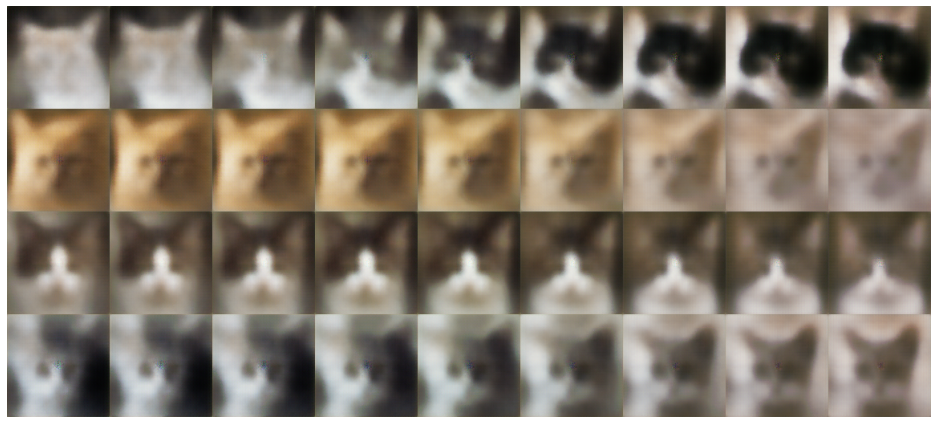

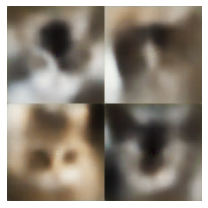

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 11 | Reconstruction loss: 4458.431307016693 | KLD loss: 294.65866140993484


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 12 | Reconstruction loss: 4340.1140754652315 | KLD loss: 299.58102630236135


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 13 | Reconstruction loss: 4301.24594173076 | KLD loss: 305.5741419347917


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 14 | Reconstruction loss: 4196.704818820361 | KLD loss: 308.529781317859


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 15 | Reconstruction loss: 4131.848625609593 | KLD loss: 307.48486408683823


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 16 | Reconstruction loss: 4085.494760454071 | KLD loss: 310.2742701939174


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 17 | Reconstruction loss: 3999.9960929917993 | KLD loss: 311.7173904987596


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 18 | Reconstruction loss: 3968.261976917338 | KLD loss: 315.02731346935957


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 19 | Reconstruction loss: 3916.139389132861 | KLD loss: 314.743425025703


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 20 | Reconstruction loss: 3880.507071737917 | KLD loss: 316.5401047890231


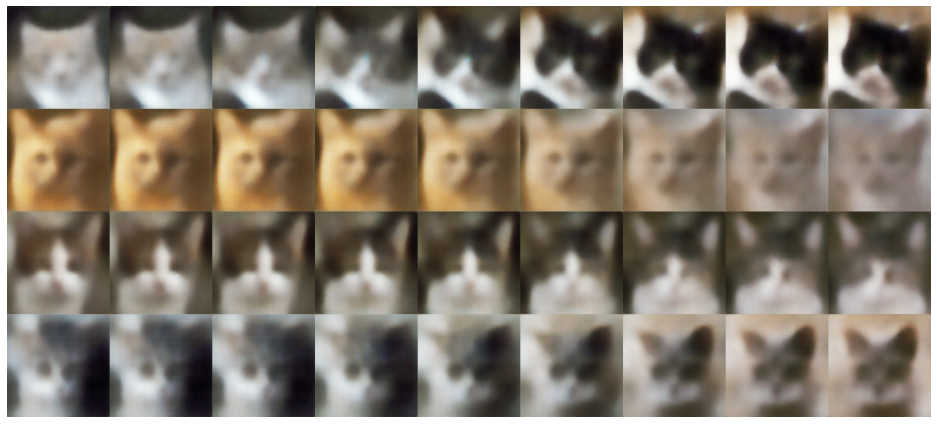

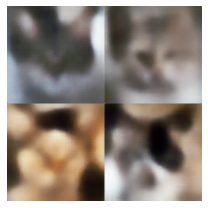

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 21 | Reconstruction loss: 3836.5308731742525 | KLD loss: 316.95889272749054


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 22 | Reconstruction loss: 3807.1510172778776 | KLD loss: 317.6546333739476


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 23 | Reconstruction loss: 3771.642540973166 | KLD loss: 319.6156706721146


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 24 | Reconstruction loss: 3729.924223905765 | KLD loss: 317.92945989762774


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 25 | Reconstruction loss: 3674.554857716057 | KLD loss: 317.70963808616494


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 26 | Reconstruction loss: 3657.2402863117477 | KLD loss: 318.4934681009802


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 27 | Reconstruction loss: 3621.4681085622087 | KLD loss: 318.8323686966985


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 28 | Reconstruction loss: 3572.2804940739034 | KLD loss: 316.90028111238655


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 29 | Reconstruction loss: 3552.2354628284525 | KLD loss: 316.2127437710022


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 30 | Reconstruction loss: 3549.3281648055367 | KLD loss: 317.99814046539876


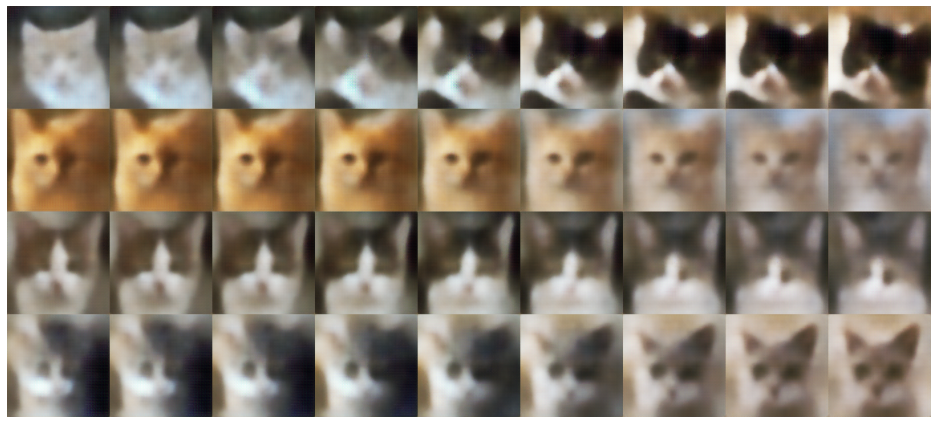

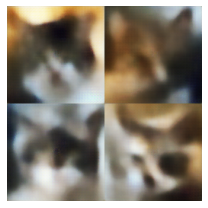

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 31 | Reconstruction loss: 3488.298874754343 | KLD loss: 318.4039011416228


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 32 | Reconstruction loss: 3468.8072854746943 | KLD loss: 317.7364334675096


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 33 | Reconstruction loss: 3447.1028150475545 | KLD loss: 315.71186586936807


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 34 | Reconstruction loss: 3428.139280710161 | KLD loss: 316.6325403533367


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 35 | Reconstruction loss: 3395.3769684785643 | KLD loss: 314.3279196697733


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 36 | Reconstruction loss: 3378.5347953464675 | KLD loss: 315.25944571169265


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 37 | Reconstruction loss: 3353.075428459215 | KLD loss: 314.0317483747968


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 38 | Reconstruction loss: 3337.353737777805 | KLD loss: 314.97238770479


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 39 | Reconstruction loss: 3319.4540194872743 | KLD loss: 314.2258356224676


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 40 | Reconstruction loss: 3302.926493200456 | KLD loss: 313.9705330984933


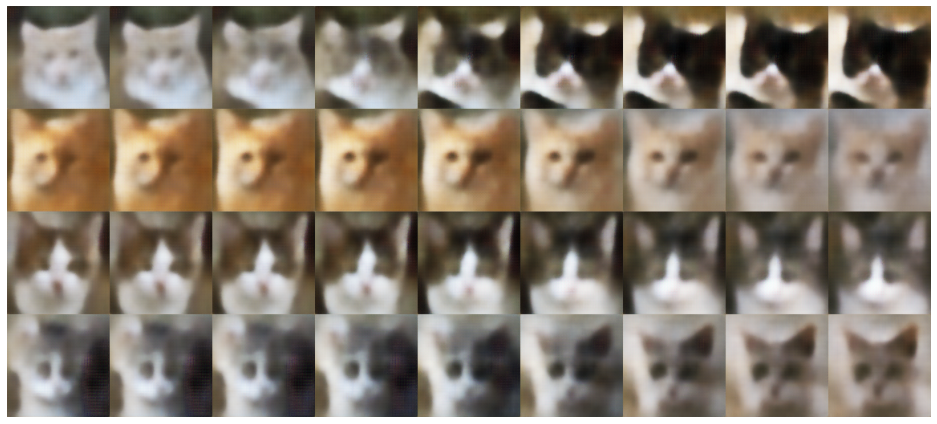

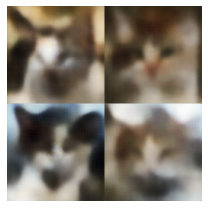

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 41 | Reconstruction loss: 3296.6373529848847 | KLD loss: 312.6351118383941


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 42 | Reconstruction loss: 3269.05222448503 | KLD loss: 314.63869244119394


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 43 | Reconstruction loss: 3255.2992820976683 | KLD loss: 310.6243936763787


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 44 | Reconstruction loss: 3240.2796259341035 | KLD loss: 310.11185663827456


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 45 | Reconstruction loss: 3217.2966672530088 | KLD loss: 311.5577879722074


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 46 | Reconstruction loss: 3194.196244328659 | KLD loss: 308.47219028828306


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 47 | Reconstruction loss: 3186.0196121879244 | KLD loss: 309.6047549988172


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 48 | Reconstruction loss: 3169.2244704347218 | KLD loss: 308.72155008256806


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 49 | Reconstruction loss: 3163.1547639266305 | KLD loss: 308.1250972866272


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 50 | Reconstruction loss: 3146.409253612068 | KLD loss: 307.9313138878864


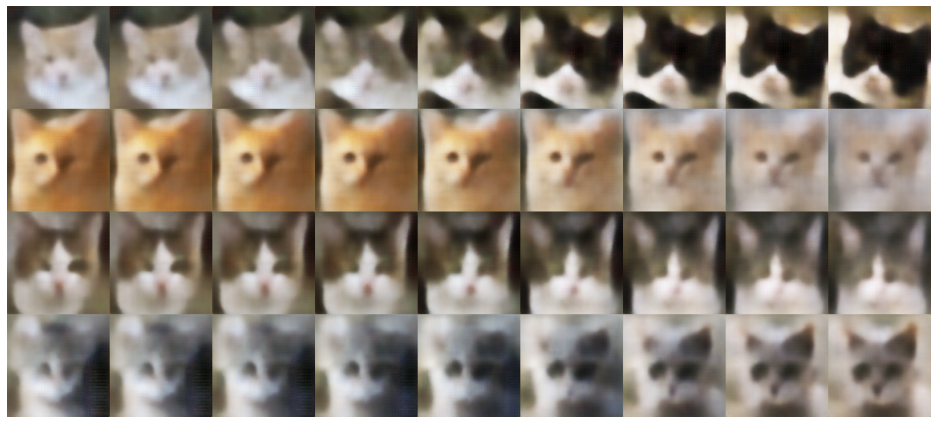

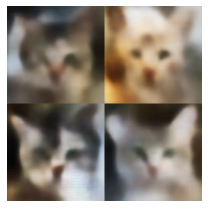

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 51 | Reconstruction loss: 3145.294933627111 | KLD loss: 307.5408170238045


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 52 | Reconstruction loss: 3122.484583505192 | KLD loss: 305.62104877922104


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 53 | Reconstruction loss: 3104.028451481221 | KLD loss: 305.1598663330078


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 54 | Reconstruction loss: 3106.0394700328757 | KLD loss: 304.7428919632242


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 55 | Reconstruction loss: 3079.169306595133 | KLD loss: 303.7292679022558


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 56 | Reconstruction loss: 3079.0369061772126 | KLD loss: 303.5387737676964


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 57 | Reconstruction loss: 3074.2226340726297 | KLD loss: 301.97460814292384


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 58 | Reconstruction loss: 3051.926721797967 | KLD loss: 301.6363844308794


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 59 | Reconstruction loss: 3037.1611322438494 | KLD loss: 301.7668856508243


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 60 | Reconstruction loss: 3037.0959131465934 | KLD loss: 300.2100464246288


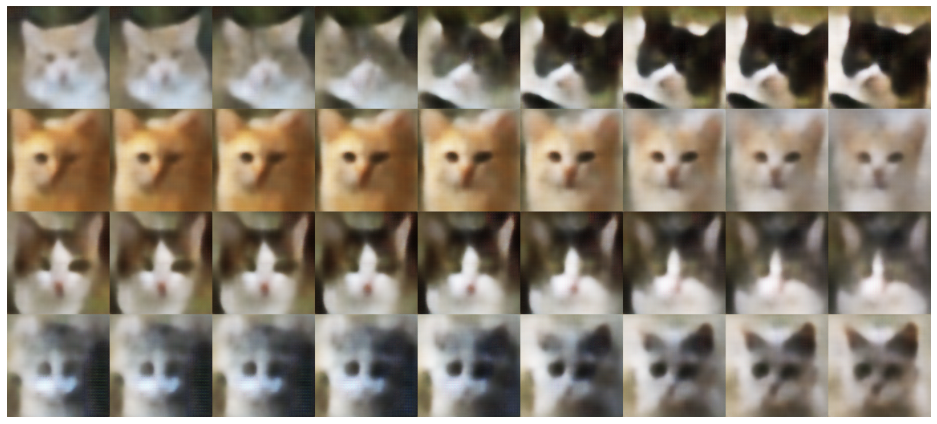

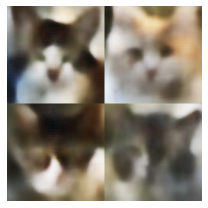

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 61 | Reconstruction loss: 3015.8613097386333 | KLD loss: 301.0211687265716


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 62 | Reconstruction loss: 3011.9462704865828 | KLD loss: 298.94879354157064


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 63 | Reconstruction loss: 2987.574611687512 | KLD loss: 297.8101567807405


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 64 | Reconstruction loss: 2988.9260576141546 | KLD loss: 297.74082733533396


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 65 | Reconstruction loss: 2979.0604268897396 | KLD loss: 295.5985337725337


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 66 | Reconstruction loss: 2975.7064360624513 | KLD loss: 295.72853803930815


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 67 | Reconstruction loss: 2964.377075953513 | KLD loss: 295.7960739135742


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 68 | Reconstruction loss: 2948.691431649723 | KLD loss: 294.43216098761707


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 69 | Reconstruction loss: 2944.0641868070047 | KLD loss: 292.5118201593435


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 70 | Reconstruction loss: 2932.995308254076 | KLD loss: 291.9852306768761


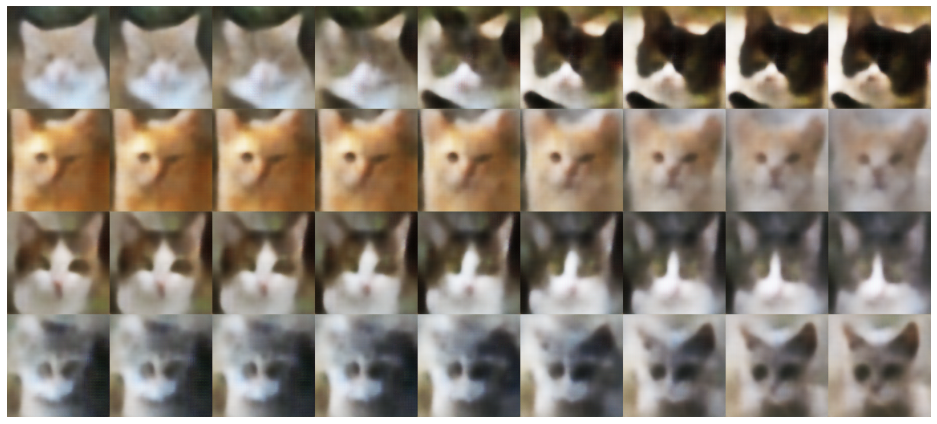

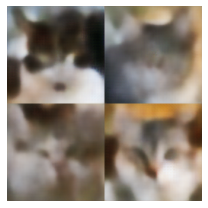

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 71 | Reconstruction loss: 2918.717119299847 | KLD loss: 291.34915469151844


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 72 | Reconstruction loss: 2925.6639434624904 | KLD loss: 291.74140489471625


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 73 | Reconstruction loss: 2915.319033415421 | KLD loss: 290.1276357899541


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 74 | Reconstruction loss: 2910.2493917334896 | KLD loss: 290.210676536797


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 75 | Reconstruction loss: 2887.410939471322 | KLD loss: 288.83838246031576


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 76 | Reconstruction loss: 2886.16488723281 | KLD loss: 287.38363946002465


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 77 | Reconstruction loss: 2879.270123215196 | KLD loss: 287.0483762847711


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 78 | Reconstruction loss: 2868.8727060637857 | KLD loss: 286.91289586606234


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 79 | Reconstruction loss: 2858.8349603688494 | KLD loss: 286.26896999193275


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 80 | Reconstruction loss: 2859.2160834081424 | KLD loss: 285.7508845358902


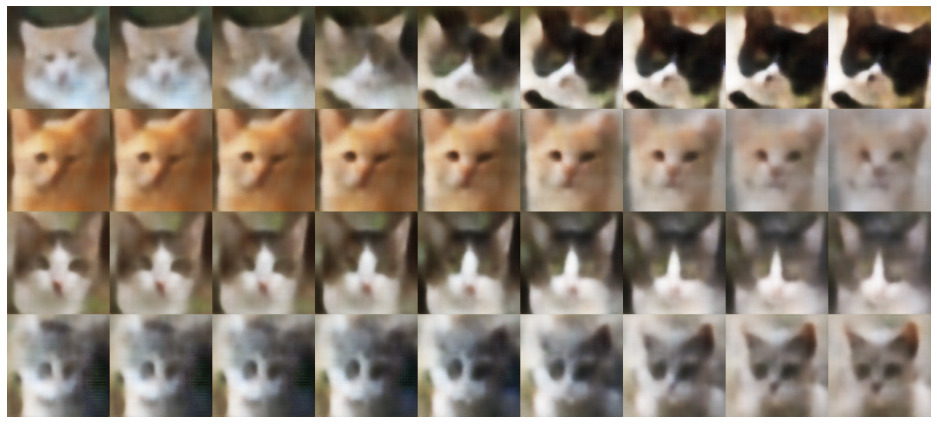

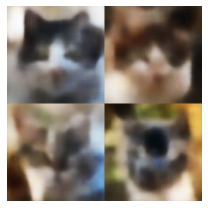

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 81 | Reconstruction loss: 2843.584615577082 | KLD loss: 284.73619567681544


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 82 | Reconstruction loss: 2832.2696921780985 | KLD loss: 283.31900692578427


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 83 | Reconstruction loss: 2840.8350907793697 | KLD loss: 283.0242502911491


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 84 | Reconstruction loss: 2835.365368766074 | KLD loss: 282.3633994819215


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 85 | Reconstruction loss: 2816.6420752483864 | KLD loss: 281.33136194833315


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 86 | Reconstruction loss: 2811.37540108817 | KLD loss: 280.5616274057708


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 87 | Reconstruction loss: 2798.6399079316893 | KLD loss: 279.94290824558425


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 88 | Reconstruction loss: 2799.3153891237625 | KLD loss: 279.512020111084


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 89 | Reconstruction loss: 2784.2686149644555 | KLD loss: 278.6365210491678


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 90 | Reconstruction loss: 2779.262270909659 | KLD loss: 278.25240633946765


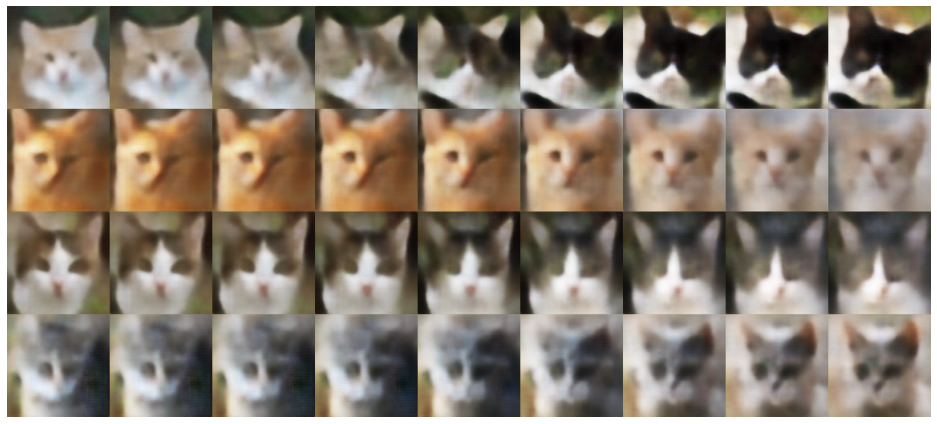

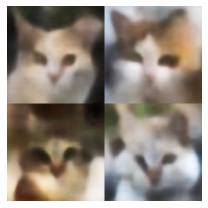

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 91 | Reconstruction loss: 2776.49899083487 | KLD loss: 276.90331607131486


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 92 | Reconstruction loss: 2785.678219812997 | KLD loss: 276.27420655244623


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 93 | Reconstruction loss: 2769.099042051327 | KLD loss: 275.78223549505196


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 94 | Reconstruction loss: 2762.1629723969454 | KLD loss: 275.87175461668403


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 95 | Reconstruction loss: 2761.179471602351 | KLD loss: 274.8161193658106


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 96 | Reconstruction loss: 2738.200490252572 | KLD loss: 273.9507905237423


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 97 | Reconstruction loss: 2745.478695697666 | KLD loss: 273.1342638856876


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 98 | Reconstruction loss: 2729.7045826408435 | KLD loss: 273.3397120837099


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 99 | Reconstruction loss: 2745.626737416901 | KLD loss: 273.3812705330227


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 100 | Reconstruction loss: 2728.6726612541247 | KLD loss: 271.66963337963415


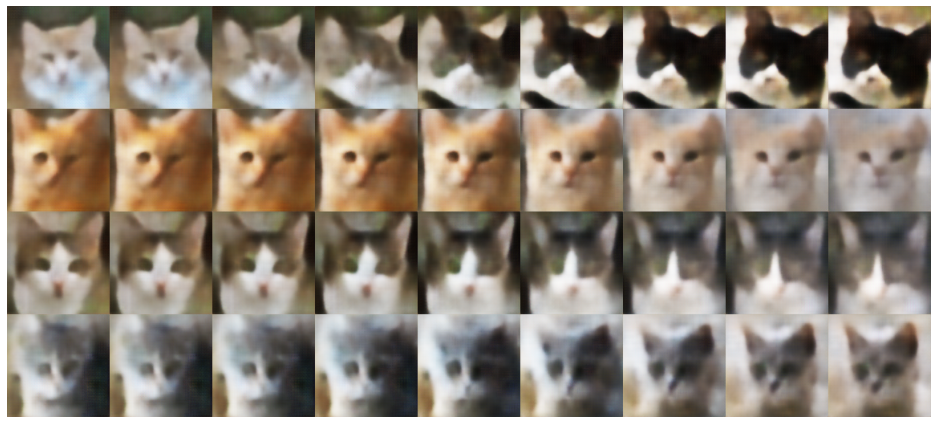

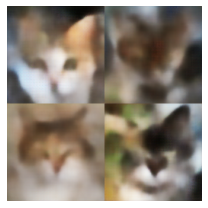

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 101 | Reconstruction loss: 2727.40297286703 | KLD loss: 271.58667636658095


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 102 | Reconstruction loss: 2704.2635268691165 | KLD loss: 269.6199622302322


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 103 | Reconstruction loss: 2709.3718104392105 | KLD loss: 269.4541448747149


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 104 | Reconstruction loss: 2695.6711266559105 | KLD loss: 268.77855725021834


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 105 | Reconstruction loss: 2697.8846272533724 | KLD loss: 270.4035749020784


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 106 | Reconstruction loss: 2708.4715957167728 | KLD loss: 268.0293938536081


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 107 | Reconstruction loss: 2690.6035510708825 | KLD loss: 268.3553161384156


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 108 | Reconstruction loss: 2684.071460415858 | KLD loss: 268.0668308423913


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 109 | Reconstruction loss: 2681.032245896618 | KLD loss: 265.6911297199889


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 110 | Reconstruction loss: 2680.4199332480107 | KLD loss: 265.79721301534903


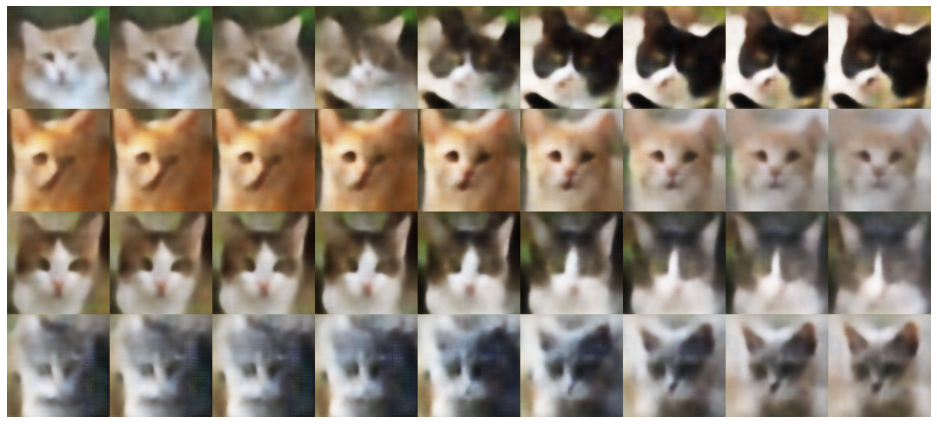

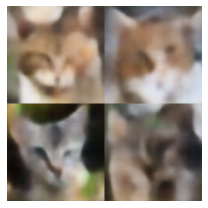

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 111 | Reconstruction loss: 2667.3145619268003 | KLD loss: 266.0279845006718


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 112 | Reconstruction loss: 2664.1792769343215 | KLD loss: 264.6266999096604


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 113 | Reconstruction loss: 2662.2658198575796 | KLD loss: 264.67042321151825


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 114 | Reconstruction loss: 2654.054999120487 | KLD loss: 264.07284927368164


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 115 | Reconstruction loss: 2658.6841955718046 | KLD loss: 263.9850402026443


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 116 | Reconstruction loss: 2648.734691548792 | KLD loss: 263.50711239642976


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 117 | Reconstruction loss: 2648.5119028032195 | KLD loss: 262.3975331324228


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 118 | Reconstruction loss: 2635.514426663796 | KLD loss: 262.838273611128


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 119 | Reconstruction loss: 2626.0315688233936 | KLD loss: 260.99587304251537


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 120 | Reconstruction loss: 2622.3228183533092 | KLD loss: 262.26762219541564


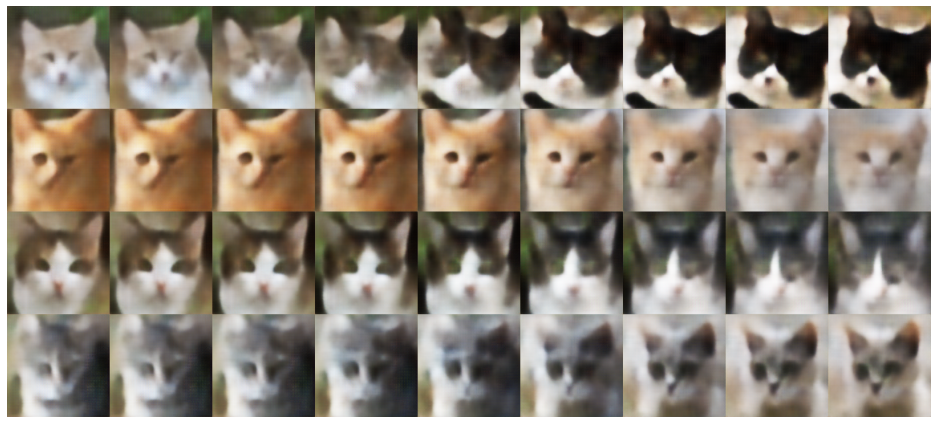

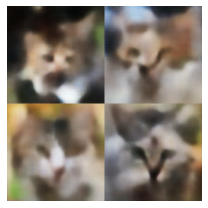

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 121 | Reconstruction loss: 2626.917219268609 | KLD loss: 262.1120385590547


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 122 | Reconstruction loss: 2615.312017026155 | KLD loss: 260.30151758134735


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 123 | Reconstruction loss: 2617.6143937199754 | KLD loss: 260.63887213475954


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 124 | Reconstruction loss: 2610.9767105386863 | KLD loss: 259.2130685652265


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 125 | Reconstruction loss: 2610.4051111825506 | KLD loss: 259.7076384265971


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 126 | Reconstruction loss: 2591.24423805379 | KLD loss: 258.5228430232646


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 127 | Reconstruction loss: 2608.130602155413 | KLD loss: 258.90131311831266


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 128 | Reconstruction loss: 2598.913925076123 | KLD loss: 257.5227673216636


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 129 | Reconstruction loss: 2597.9246619562186 | KLD loss: 258.42618266988245


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 130 | Reconstruction loss: 2591.7763491802334 | KLD loss: 256.83222281414527


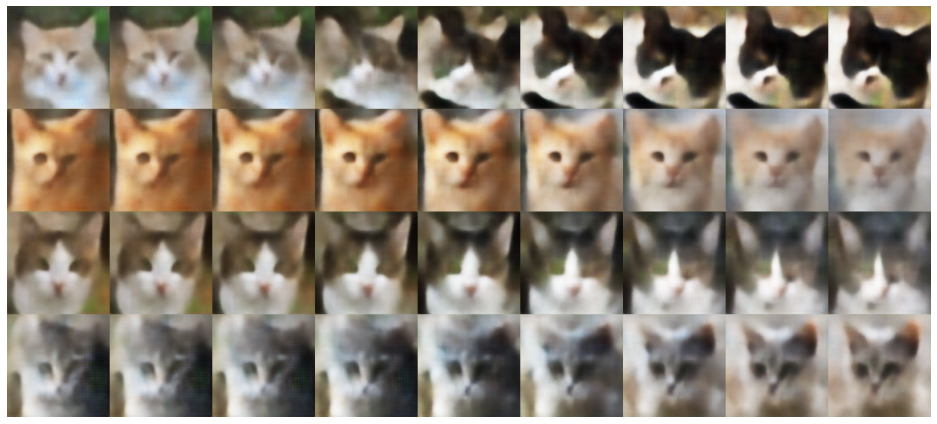

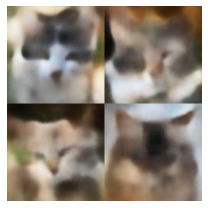

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 131 | Reconstruction loss: 2584.7187181555705 | KLD loss: 256.5900102461347


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 132 | Reconstruction loss: 2581.555857214128 | KLD loss: 256.88066027623523


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 133 | Reconstruction loss: 2584.930128014606 | KLD loss: 256.2041565794382


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 134 | Reconstruction loss: 2582.0563309000145 | KLD loss: 256.0245519128645


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 135 | Reconstruction loss: 2580.933702930901 | KLD loss: 255.20798589576106


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 136 | Reconstruction loss: 2565.9791390555247 | KLD loss: 254.42049924483211


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 137 | Reconstruction loss: 2566.8000696786444 | KLD loss: 253.74605937033706


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 138 | Reconstruction loss: 2563.5211820424715 | KLD loss: 254.16829468152537


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 139 | Reconstruction loss: 2565.5124130722897 | KLD loss: 253.09873853410994


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 140 | Reconstruction loss: 2550.716003607519 | KLD loss: 254.31049112355487


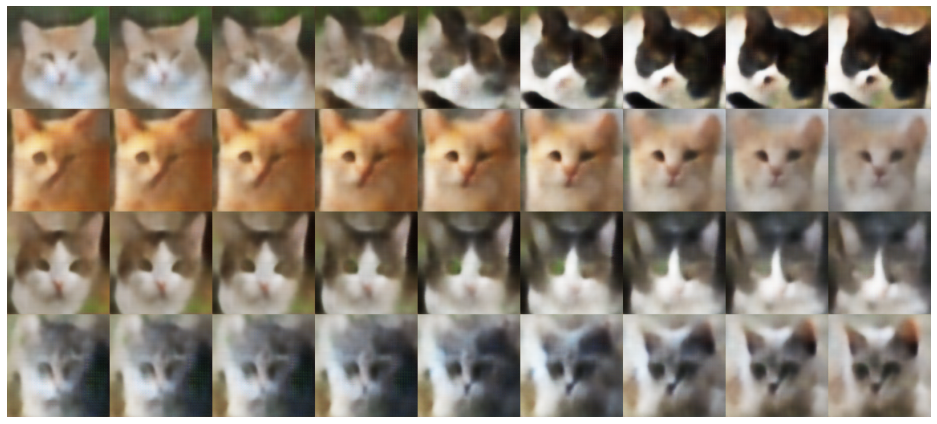

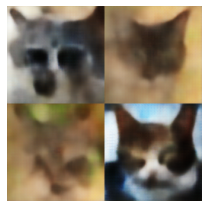

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 141 | Reconstruction loss: 2546.7399362125752 | KLD loss: 251.71353734650228


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 142 | Reconstruction loss: 2541.8259673503617 | KLD loss: 252.5805033097356


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 143 | Reconstruction loss: 2544.2304130222487 | KLD loss: 250.3422236472183


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 144 | Reconstruction loss: 2531.1158329744517 | KLD loss: 251.57035595437756


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 145 | Reconstruction loss: 2541.071143677516 | KLD loss: 251.2444999410499


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 146 | Reconstruction loss: 2528.962807033373 | KLD loss: 251.06839768782905


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 147 | Reconstruction loss: 2533.231972830636 | KLD loss: 250.37490513013756


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 148 | Reconstruction loss: 2522.9186244040543 | KLD loss: 250.72952516923039


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 149 | Reconstruction loss: 2516.627219063895 | KLD loss: 249.8146066606415


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 150 | Reconstruction loss: 2522.85554457007 | KLD loss: 249.3373007211626


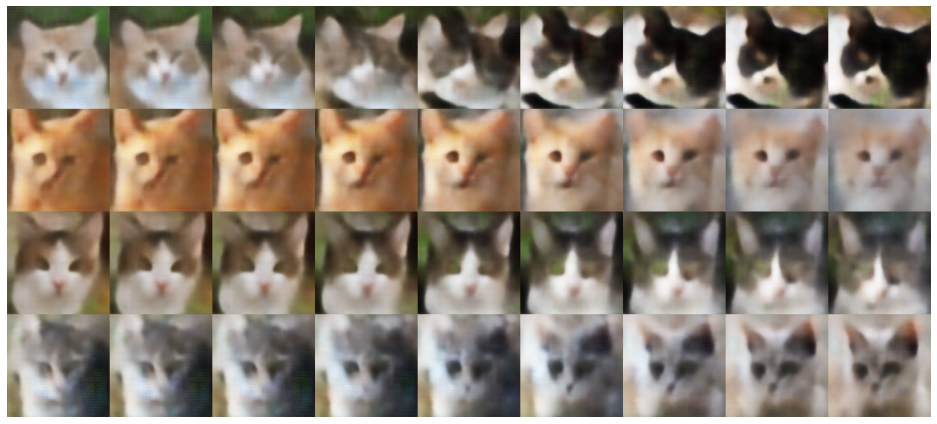

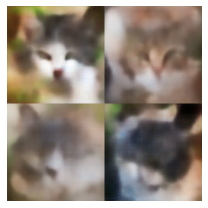

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 151 | Reconstruction loss: 2511.6991029348433 | KLD loss: 249.15178372400888


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 152 | Reconstruction loss: 2508.0807299880507 | KLD loss: 248.65922340250904


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 153 | Reconstruction loss: 2510.803845897224 | KLD loss: 248.0704525775791


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 154 | Reconstruction loss: 2506.814208605275 | KLD loss: 247.67887432975058


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 155 | Reconstruction loss: 2504.9656006238474 | KLD loss: 247.98869072576488


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 156 | Reconstruction loss: 2501.1714668984737 | KLD loss: 247.4637446196183


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 157 | Reconstruction loss: 2502.1801958735687 | KLD loss: 247.49284227738468


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 158 | Reconstruction loss: 2494.6183610051316 | KLD loss: 247.0353581446298


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 159 | Reconstruction loss: 2488.1351665236193 | KLD loss: 246.240784757626


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 160 | Reconstruction loss: 2491.332053996021 | KLD loss: 245.50736682015176


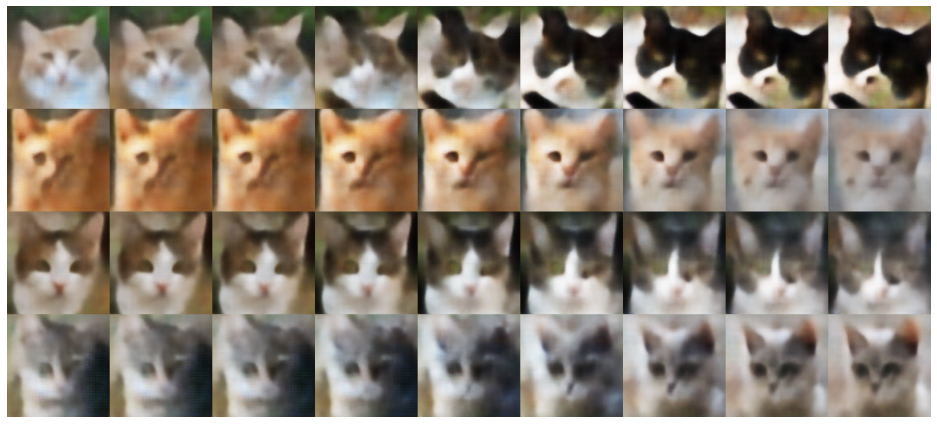

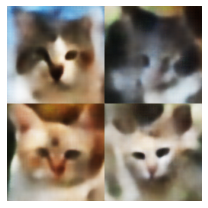

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 161 | Reconstruction loss: 2483.6583991198804 | KLD loss: 245.01853405022473


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 162 | Reconstruction loss: 2485.5522051509124 | KLD loss: 245.40825366381532


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 163 | Reconstruction loss: 2491.7378663246677 | KLD loss: 246.16350233184625


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 164 | Reconstruction loss: 2472.33498254622 | KLD loss: 244.15236732530298


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 165 | Reconstruction loss: 2467.8536005434785 | KLD loss: 245.34434222582703


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 166 | Reconstruction loss: 2471.394034249442 | KLD loss: 244.15004524088795


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 167 | Reconstruction loss: 2468.9646932471614 | KLD loss: 244.74196643710877


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 168 | Reconstruction loss: 2467.994087740501 | KLD loss: 244.26685811866145


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 169 | Reconstruction loss: 2464.4178243127667 | KLD loss: 243.4398322964307


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 170 | Reconstruction loss: 2460.1761921947787 | KLD loss: 243.8809823693696


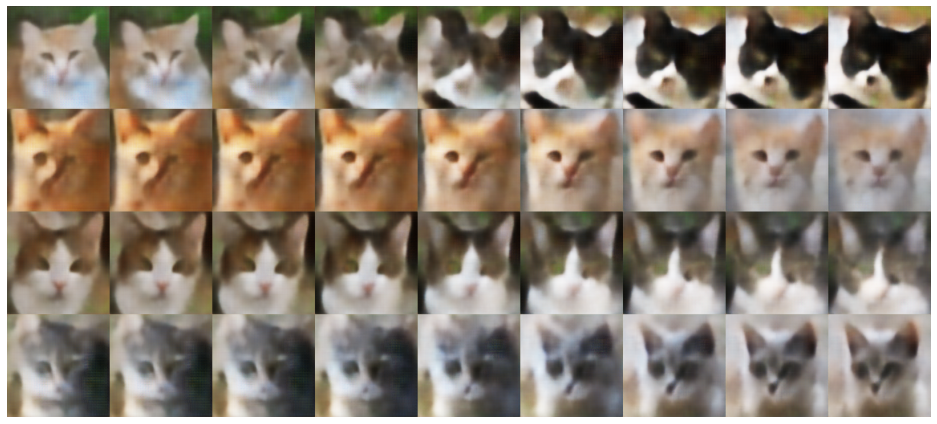

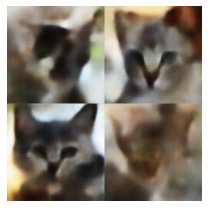

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 171 | Reconstruction loss: 2461.47044268306 | KLD loss: 242.6405952169288


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 172 | Reconstruction loss: 2457.2270187472704 | KLD loss: 243.23565138348883


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 173 | Reconstruction loss: 2456.373226947666 | KLD loss: 242.6934218791701


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 174 | Reconstruction loss: 2448.158837549435 | KLD loss: 242.06463838660198


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 175 | Reconstruction loss: 2456.332395944536 | KLD loss: 241.9167723566849


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 176 | Reconstruction loss: 2442.0435392960258 | KLD loss: 241.35914813213466


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 177 | Reconstruction loss: 2439.785396030971 | KLD loss: 242.25565070395143


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 178 | Reconstruction loss: 2445.6647035586907 | KLD loss: 240.61881616248849


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 179 | Reconstruction loss: 2437.494821868328 | KLD loss: 240.66031108879895


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 180 | Reconstruction loss: 2438.8042096440095 | KLD loss: 240.62447575160436


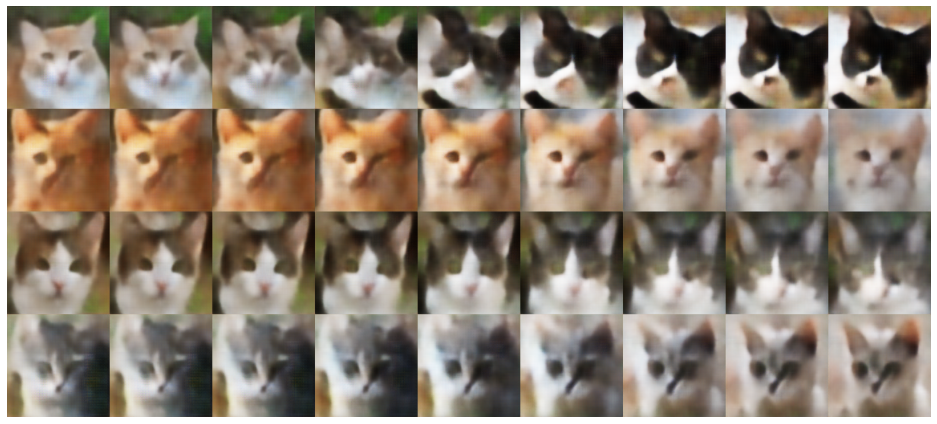

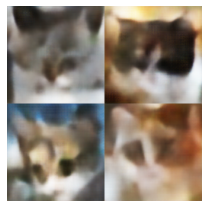

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 181 | Reconstruction loss: 2429.8001032290254 | KLD loss: 239.39665805034755


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 182 | Reconstruction loss: 2427.9752130923066 | KLD loss: 239.49399599821672


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 183 | Reconstruction loss: 2435.3505785450434 | KLD loss: 240.024210627775


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 184 | Reconstruction loss: 2433.7005649353405 | KLD loss: 239.60245938034532


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 185 | Reconstruction loss: 2426.8394098696504 | KLD loss: 239.20437141086745


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 186 | Reconstruction loss: 2419.2130843452787 | KLD loss: 239.2465006905313


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 187 | Reconstruction loss: 2420.6429422508854 | KLD loss: 238.4331640160602


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 188 | Reconstruction loss: 2426.190848593386 | KLD loss: 239.32897382937603


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 189 | Reconstruction loss: 2422.752342650609 | KLD loss: 239.03039162203393


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 190 | Reconstruction loss: 2402.0960354064564 | KLD loss: 237.92608059711338


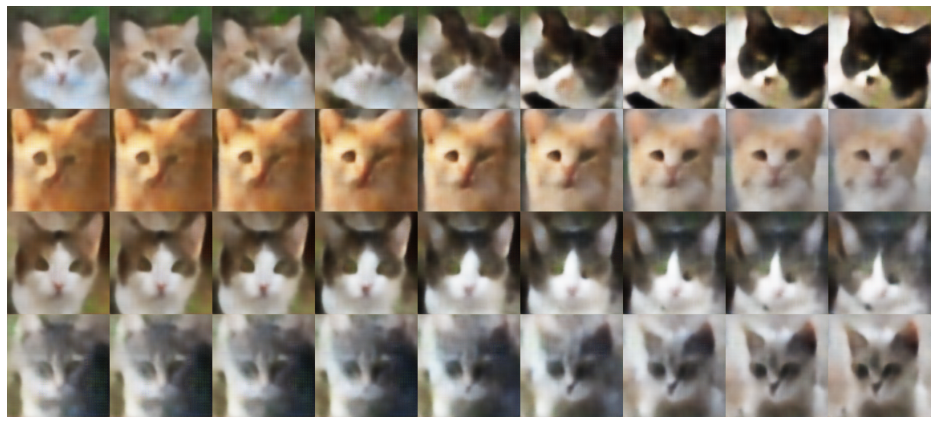

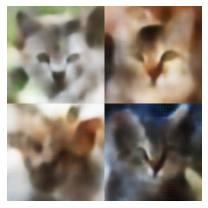

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 191 | Reconstruction loss: 2416.4374419976466 | KLD loss: 238.11496872043017


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 192 | Reconstruction loss: 2410.4551404870076 | KLD loss: 237.74184396400216


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 193 | Reconstruction loss: 2397.5293027510556 | KLD loss: 237.82527433122908


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 194 | Reconstruction loss: 2402.198158595873 | KLD loss: 236.87260001046317


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 195 | Reconstruction loss: 2402.2663807365466 | KLD loss: 236.76561604375425


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 196 | Reconstruction loss: 2397.997737908215 | KLD loss: 236.49216155531985


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 197 | Reconstruction loss: 2402.6143594113937 | KLD loss: 237.29912301768428


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 198 | Reconstruction loss: 2387.1345563616073 | KLD loss: 235.8119859873138


  0%|          | 0/645 [00:00<?, ?it/s]

In [ ]:
def train_vae():
    vae = VAE()
    vae.cuda()

    epochs = 201
    batch_size = 8
    vae_optim = Adam(vae.parameters(), lr=1e-4)

    dataset = CatDataset(size=128)

    test_imgs_1 = torch.cat([dataset[i].unsqueeze(0) for i in (0, 34, 76, 1509)])
    test_imgs_2 = torch.cat([dataset[i].unsqueeze(0) for i in (734, 123, 512, 3634)])

    for ep in range(epochs):
        dataloader = DataLoader(dataset, shuffle=True, batch_size=batch_size)
        total_batches = 0
        rec_loss_avg = 0
        kld_loss_avg = 0

        if ep % 10 == 0:
            with torch.no_grad():
                z_1 = vae.encode(test_imgs_1.cuda())
                z_2 = vae.encode(test_imgs_2.cuda())
                x_int = []
                for i in range(9):
                    z = (i * z_1 + (8 - i) * z_2) / 8
                    x_int.append(vae.decode(z))
                x_int = torch.cat(x_int)
                visualise(x_int, rows=len(test_imgs_1))
                z_rand = torch.randn_like(z_1)
                x_int = vae.decode(z_rand)
                visualise(x_int, rows=len(test_imgs_1)//2)

        for i, batch in tqdm(enumerate(dataloader), total=(len(dataset) + batch_size) // batch_size):
            if len(batch) < batch_size:
                continue
            total_batches += 1
            x = batch.cuda()
            x_rec, kld = vae(x)
            img_elems = float(np.prod(list(batch.size())))
            kld_loss = kld.sum() / batch_size
            rec_loss = ((x_rec - x)**2).sum() / batch_size
            loss = rec_loss + 0.4 * kld_loss # https://openreview.net/forum?id=Sy2fzU9gl
            vae_optim.zero_grad()
            loss.backward()
            vae_optim.step()
            kld_loss_avg += kld_loss.item()
            rec_loss_avg += rec_loss.item()

        print(f"Epoch {ep+1} | Reconstruction loss: {rec_loss_avg / total_batches} | KLD loss: {kld_loss_avg / total_batches}")

    vae.save()
    vae.load()

train_vae()
